# Описание файлов проекта

Описание файлов проекта:


Для тренировки всех моделей в проекте используется класс Training (размещен в файле training.py). Написан с использованием IGNITE (https://github.com/pytorch/ignite).


Основной момент - это использование планировщиков LR. Класс позволяет тренировать модели  с использоваием


StepLR(optimizer=self.optimizer, step_size=1, gamma=0.7)


и


OneCycleLR(self.optimizer, max_lr=0.1, pct_start=0.2, total_steps=len(self.train_loader) * self.num_epochs,div_factor=25,final_div_factor=10))


или не используя планировщик. Переключение между ними осуществляется с помощью задания первых трех букв имени модели (не очень удобно, но работает). Если имя модели 
начинается с 'Vit', то работает StepLR, если имя 'VIT', то 'OneCycleLR', если имя другое, то ни один из них не используется. Класс позволяет выводит метрики и логи в тензорборд.


Класс модели VIT -  VisionTransformer (размещен в файле model.py). Код не претендует на оригинальность, тк писался для того чтобы лучше понять работу модели и возможность реализовать 2D (абсолютные) позиционные эмбеддинги, а также гибридную модель. 


(2D эмбеддинги изначально были в задании. К сожалению, информацию нашел только об относительных 2D  эмбеддингах, поэтому не знаю верно ли их реализовал. Прироста качества при тренировке они не дают.)


В папке проекта содержаться следующие папки:


tb_logs_vit_vgg_pre - логи для тензорборда тренировки моделей 1ой части проекта на датасете Plants,


tb_logs_vit_vgg_pre_dc - логи для тензорборда тренировки моделей 1ой части проекта на датасете Dog vs Cats,


saved model -  с файлами сохраненных моделей из 3й части проекта,


tb_log_vit_resvit -   логи для тензорборда тренировки обычной и гибридной модели,


tb_log_vit_new - лог для тензорборда модели vit_new из 3й части проекта.


Архивы датвсетов:


224_200.zip - датасет Plants, этот датасет был создан из фотогрвфий использованных в реальном проекте по определению болезней растений в боксах для их выращивания.


dogs-vs-cats-redux-kernels-edition.zip


# Visual Transformer(part 1)
https://paperswithcode.com/paper/an-image-is-worth-16x16-words-transformers-1

Github links:

* [google-research/vision_transformer](https://github.com/google-research/vision_transformer)
*  [lucidrains/vit-pytorch](https://github.com/lucidrains/vit-pytorch)
* [lukemelas/PyTorch-Pretrained-ViT](https://github.com/lukemelas/PyTorch-Pretrained-ViT)

## Задание
1. Выбрать удобный для вас датасет, например, любое соревнование по CV. Пример приведен на датасете Dogs vs Cats Data
2. Взять любую предобученную модель VIT и затем сделать finetuning на вашем датасете
3. Сравнить по качеству с любой CNN моделью

## Import Libraries

In [ ]:
from __future__ import print_function
import glob
from itertools import chain
import os
import random
import cv2

import matplotlib.pyplot as plt

import numpy as np
import pandas as pd
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim

from pathlib import Path
from sklearn.preprocessing import LabelEncoder

from PIL import Image
from matplotlib import ticker
from sklearn.model_selection import train_test_split
from torch.optim.lr_scheduler import StepLR
from torch.utils.data import DataLoader, Dataset
from torchvision import datasets, transforms
from tqdm.notebook import tqdm
from google.colab import drive
drive.mount('/content/gdrive')

Drive already mounted at /content/gdrive; to attempt to forcibly remount, call drive.mount("/content/gdrive", force_remount=True).


In [ ]:
seed = 42
def seed_everything(seed):
    random.seed(seed)
    os.environ['PYTHONHASHSEED'] = str(seed)
    np.random.seed(seed)
    torch.manual_seed(seed)
    torch.cuda.manual_seed(seed)
    torch.cuda.manual_seed_all(seed)
    torch.backends.cudnn.deterministic = True

seed_everything(seed)

## Load Data

* Dogs vs. Cats Redux: Kernels Edition - https://www.kaggle.com/c/dogs-vs-cats-redux-kernels-edition
* Base Code - https://www.kaggle.com/reukki/pytorch-cnn-tutorial-with-cats-and-dogs/


In [ ]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

In [ ]:
DATA_DIR = '/content/Plants_224'
if not os.path.exists(DATA_DIR):
    os.makedirs(DATA_DIR)

In [ ]:
%cd /content/Plants_224

/content/Plants_224


In [ ]:
!cp /content/gdrive/'My Drive'/Goncharov_Alexey_VIT_project/224_200.zip .
!unzip 224_200.zip

In [ ]:
%cd /content
!cp /content/gdrive/'My Drive'/Goncharov_Alexey_VIT_project/training.py .

/content


In [ ]:
path = sorted(Path('/content/Plants_224/224_200').rglob("*.png"))
path_ = sorted(Path('/content/Plants_224/224_200').rglob("*.jpg"))
data_path = path + path_
data = pd.DataFrame()
data['paths'] = [str(path) for path in data_path]
data['names'] = [path.split('/')[-2][4:] for path in data['paths']]

le = LabelEncoder()
le.fit(data.names.unique())
data['classes'] = le.transform(data.names)
data.head(10)

,paths,names,classes
0,/content/Plants_224/224_200/224_arugula/4010.png,arugula,0
1,/content/Plants_224/224_200/224_arugula/4013.png,arugula,0
2,/content/Plants_224/224_200/224_arugula/4016.png,arugula,0
3,/content/Plants_224/224_200/224_arugula/4019.png,arugula,0
4,/content/Plants_224/224_200/224_arugula/4022.png,arugula,0
5,/content/Plants_224/224_200/224_arugula/4025.png,arugula,0
6,/content/Plants_224/224_200/224_arugula/4028.png,arugula,0
7,/content/Plants_224/224_200/224_arugula/4031.png,arugula,0
8,/content/Plants_224/224_200/224_arugula/4034.png,arugula,0
9,/content/Plants_224/224_200/224_arugula/4037.png,arugula,0


## Split

In [ ]:
train_ind = []
valid_ind = []
test_ind = []

for cls in range(len(le.classes_)): 
    indexes = list(data[data.classes.isin([cls])].index)
    x_train, x_valid_ = train_test_split(indexes, 
                                         train_size=0.7, 
                                         random_state=42)
    x_valid, x_test = train_test_split(x_valid_, 
                                       train_size=0.5, 
                                       random_state=42)
    train_ind += x_train
    valid_ind += x_valid
    test_ind += x_test

In [ ]:
print(f"Train Data: {len(train_ind)}")
print(f"Valid Data: {len(valid_ind)}")
print(f"Test Data: {len(test_ind)}")

Train Data: 5176
Valid Data: 1112
Test Data: 1128


## Random Plots

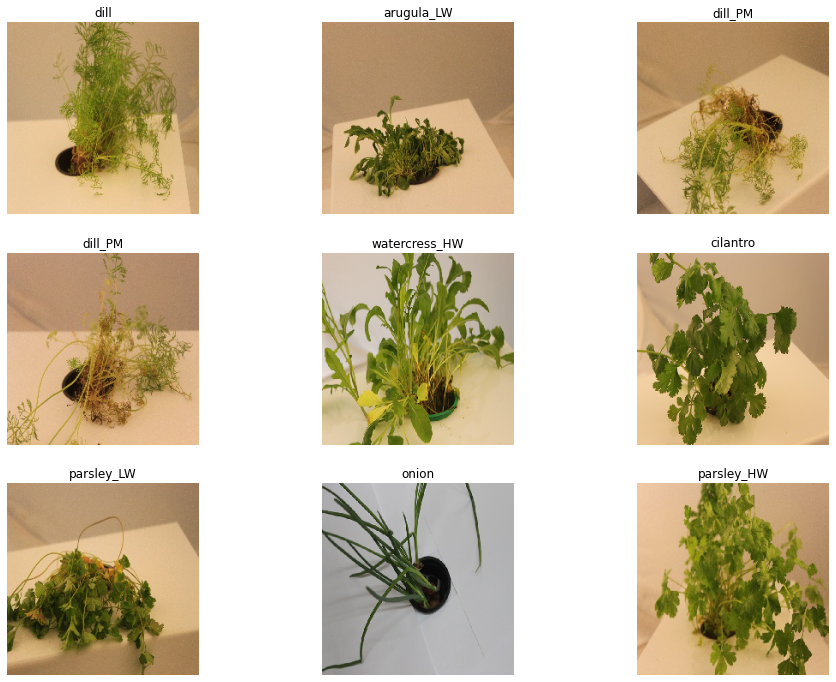

In [ ]:
random_idx = np.random.randint(1, len(train_ind), size=9)

fig, axes = plt.subplots(3, 3, figsize=(16, 12))

for idx, ax in enumerate(axes.ravel()):
   image_path = data.loc[train_ind[random_idx[idx]]].paths
   label = data.loc[train_ind[random_idx[idx]]].names
   img = Image.open(image_path)
   ax.set_title(label)
   ax.axis('off')
   ax.imshow(img)

## Image Augumentation

In [ ]:
# create image augmentations
transforms_train = transforms.Compose(
    [
        transforms.RandomHorizontalFlip(p=0.3),
        transforms.RandomVerticalFlip(p=0.3),
        transforms.ToTensor(),
        transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
    ]
)

transforms_valid = transforms.Compose(
    [
        transforms.ToTensor(),
        transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
    ]
)

## Load Datasets

In [ ]:
class MyDataset(Dataset):
    def __init__(self, data, indexes, transform):
        self.data = data
        self.indexes = indexes
        self.transform = transform

    def __len__(self):
        return len(self.indexes)

    def __getitem__(self, idx):
        image_filepath = self.data.loc[self.indexes[idx]].paths
        img = Image.open(image_filepath)
        label = self.data.loc[self.indexes[idx]].classes
        image = self.transform(img.convert('RGB'))

        return image, label


In [ ]:
# Training settings
torch.cuda.empty_cache()
batch_size = 32

In [ ]:
train_data = MyDataset(data, train_ind,  transform=transforms_train)
valid_data = MyDataset(data, valid_ind, transform=transforms_valid)
test_data = MyDataset(data, test_ind, transform=transforms_valid)
train_loader = DataLoader(dataset=train_data, batch_size=batch_size, shuffle=True)
valid_loader = DataLoader(dataset=valid_data, batch_size=batch_size, shuffle=False)
test_loader = DataLoader(dataset=test_data, batch_size=batch_size, shuffle=False)

In [ ]:
print(len(train_data), len(train_loader))

5176 162


In [ ]:
print(len(valid_data), len(valid_loader))

1112 35


## Training

In [ ]:
!pip install git+https://github.com/pytorch/ignite

  Cloning https://github.com/pytorch/ignite to /tmp/pip-req-build-00hb52jk
  Running command git clone -q https://github.com/pytorch/ignite /tmp/pip-req-build-00hb52jk
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
    Preparing wheel metadata ... done
  Created wheel for pytorch-ignite: filename=pytorch_ignite-0.5.0-cp37-none-any.whl size=227585 sha256=2bee7290a77451de9ba362fb1b7504c9ed3b999181e8259af307d6e1843cb341
  Stored in directory: /tmp/pip-ephem-wheel-cache-7z39dy14/wheels/92/9a/cd/39c0bc302c48329ecbe3a0d8b56678725a25332c7e9100d3b5
Successfully built pytorch-ignite


In [ ]:
import training
import imp 
imp.reload(training)
from training import Training

In [ ]:
!kill 1780

In [ ]:
%cd /content
%reload_ext tensorboard
%tensorboard --logdir "tb_logs_vit_vgg_pre"

Output hidden; open in https://colab.research.google.com to view.

## Pretrained VIT + Pretrained VGG

In [ ]:
!pip install pytorch-pretrained-vit

In [ ]:
import pytorch_pretrained_vit
model_name = 'B_16_imagenet1k'
vit_pre = pytorch_pretrained_vit.ViT(model_name, 
                                     image_size=224, 
                                     pretrained=True,
                                     num_classes=33)

Resized positional embeddings from torch.Size([1, 577, 768]) to torch.Size([1, 197, 768])
Loaded pretrained weights.


In [ ]:
from torchvision.models import vgg16_bn
vgg_pre = vgg16_bn(pretrained=True)

In [ ]:
# Меняем последний слой классификатора в модели vgg_pre
vgg_pre.classifier[6] = nn.Linear(4096, 33, bias=True)
vgg_pre

VGG(
  (features): Sequential(
    (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (4): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (7): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (8): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (9): ReLU(inplace=True)
    (10): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (11): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (12): ReLU(inplace=True)
    (13): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (14): Conv2d(128, 256

In [ ]:
# Замораживаю все слои
for param in vgg_pre.parameters():  
    param.requires_grad = False

# Размораживаем последний слой
for param in vgg_pre.classifier[6].parameters():
    param.requires_grad = True

# посмотрим какие параметры нейросети мы учим
params_to_update = []
for name,param in vgg_pre.named_parameters():
    if param.requires_grad == True:
        params_to_update.append(param)
        print("\t",name)     

	 classifier.6.weight
	 classifier.6.bias


In [ ]:
training_vit_pre = Training(device=device, 
                            model=vit_pre.to(device), 
                            name='Vit pre', 
                            log_dir='tb_logs_vit_vgg_pre') 

training_vgg_pre = Training(device=device, 
                            model=vgg_pre.to(device), 
                            name='Vgg pre',
                            log_dir="tb_logs_vit_vgg_pre") 

training_models = [training_vit_pre, training_vgg_pre]

In [ ]:
def count_parameters(model):
    return sum(p.numel() for p in model.parameters() if p.requires_grad)

for mod in training_models:
    print(f'The model {mod.name} has {count_parameters(mod.model):,} trainable parameters')


The model Vit pre has 85,824,033 trainable parameters
The model Vgg pre has 135,201 trainable parameters



Model Vit pre epoch 1/2 : 162, lr: 0.003000,  train loss: 0.043



Model Vit pre epoch 1/2 : 35, lr: 0.003000,  valid loss: 0.030,  valid accuracy: 0.996



Model Vit pre epoch 2/2 : 324, lr: 0.002100,  train loss: 0.016



Model Vit pre epoch 2/2 : 35, lr: 0.002100,  valid loss: 0.015,  valid accuracy: 0.997



Model Vit pre epoch 2/2 : 36, test accuracy : 1.00
 arugula recall : 1.00,        arugula precision : 0.94
 arugula_HL recall : 1.00,     arugula_HL precision : 1.00
 arugula_HW recall : 1.00,     arugula_HW precision : 1.00
 arugula_LL recall : 1.00,     arugula_LL precision : 1.00
 arugula_LW recall : 1.00,     arugula_LW precision : 1.00
 bazil recall : 1.00,          bazil precision : 1.00
 bazil_LL recall : 1.00,       bazil_LL precision : 1.00
 cilantro recall : 1.00,       cilantro precision : 1.00
 cilantro_HL recall : 1.00,    cilantro_HL precision : 1.00
 cilantro_HW recall : 1.00,    cilantro_HW precision : 1.00
 dill recall : 1.00,           dill precision : 1.00
 dill_HL recall : 1.00,        dill_HL precision : 1.00
 dill_HW recall : 1.00,        dill_HW precision : 1.00
 dill_LL recall : 0.97,        dill_LL precision : 1.00
 dill_LW recall : 1.00,        dill_LW precision : 0.98
 dill_PM recall : 1.00,        dill_PM precision : 1.00
 mint recall : 1.00,           mint

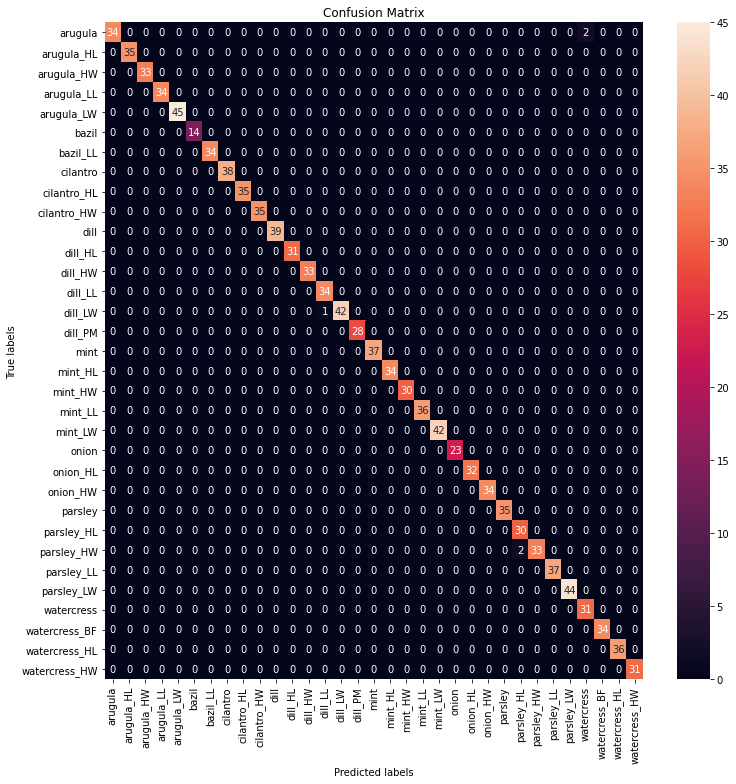

/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:718: UserWarning: Named tensors and all their associated APIs are an experimental feature and subject to change. Please do not use them for anything important until they are released as stable. (Triggered internally at  /pytorch/c10/core/TensorImpl.h:1156.)
  return torch.max_pool2d(input, kernel_size, stride, padding, dilation, ceil_mode)



Model Vgg pre epoch 1/3 : 162, lr: 0.003000,  train loss: 0.160



Model Vgg pre epoch 1/3 : 35, lr: 0.003000,  valid loss: 0.053,  valid accuracy: 0.992



Model Vgg pre epoch 2/3 : 324, lr: 0.003000,  train loss: 0.083



Model Vgg pre epoch 2/3 : 35, lr: 0.003000,  valid loss: 0.074,  valid accuracy: 0.986



Model Vgg pre epoch 3/3 : 486, lr: 0.003000,  train loss: 0.106



Model Vgg pre epoch 3/3 : 35, lr: 0.003000,  valid loss: 0.047,  valid accuracy: 0.989



Model Vgg pre epoch 3/3 : 36, test accuracy : 0.99
 arugula recall : 1.00,        arugula precision : 0.94
 arugula_HL recall : 1.00,     arugula_HL precision : 1.00
 arugula_HW recall : 1.00,     arugula_HW precision : 1.00
 arugula_LL recall : 0.97,     arugula_LL precision : 1.00
 arugula_LW recall : 1.00,     arugula_LW precision : 1.00
 bazil recall : 1.00,          bazil precision : 1.00
 bazil_LL recall : 1.00,       bazil_LL precision : 1.00
 cilantro recall : 1.00,       cilantro precision : 1.00
 cilantro_HL recall : 1.00,    cilantro_HL precision : 1.00
 cilantro_HW recall : 1.00,    cilantro_HW precision : 1.00
 dill recall : 1.00,           dill precision : 0.97
 dill_HL recall : 1.00,        dill_HL precision : 1.00
 dill_HW recall : 1.00,        dill_HW precision : 0.97
 dill_LL recall : 1.00,        dill_LL precision : 1.00
 dill_LW recall : 1.00,        dill_LW precision : 0.98
 dill_PM recall : 0.93,        dill_PM precision : 1.00
 mint recall : 1.00,           mint

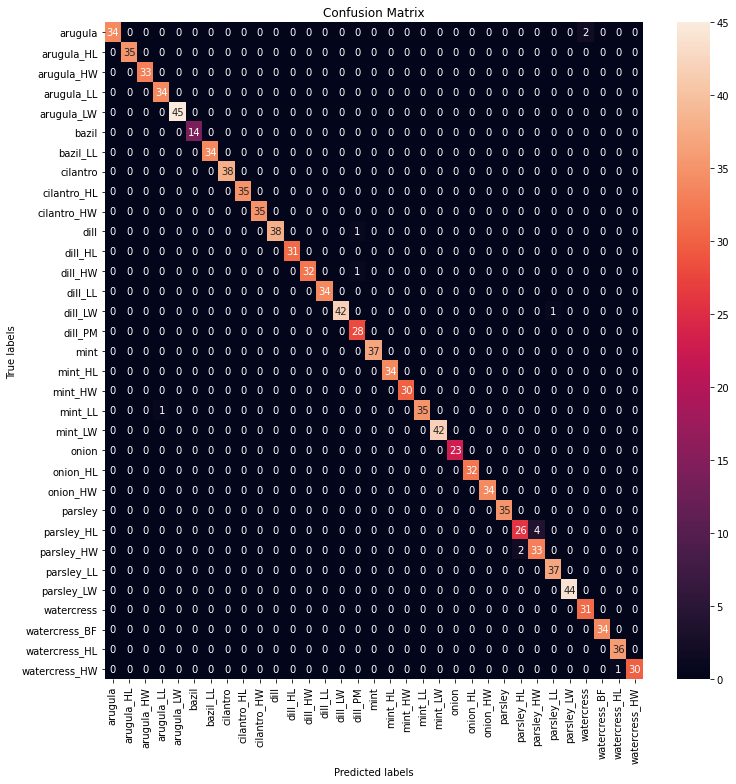

In [ ]:
for i, m in enumerate(training_models):
    # определяем оптимайзер
    params = [p for p in m.model.parameters() if p.requires_grad]
    if m.name == 'Vgg pre':
        optimizer = torch.optim.AdamW(params,lr=3e-3)
        clip = None
        num_epoch = 3
    if m.name == 'Vit pre':
        optimizer = optim.Adam([{"params": params[-2:], "lr": 3e-3},
                                {"params": params[:-2],"lr": 2e-5}])
        clip = 1
        num_epoch = 2
    criterion = nn.CrossEntropyLoss()
    m.load_config(optimizer, criterion, num_epoch, train_loader, valid_loader, test_loader, list(le.classes_), clip=clip)
    m.run_training_loop()

## DOG CATS

In [ ]:
DATA_DIR_ = '/content/DogCats'
if not os.path.exists(DATA_DIR_):
    os.makedirs(DATA_DIR_)

In [ ]:
%cd /content/DogCats

/content/DogCats


In [ ]:
!cp /content/gdrive/'My Drive'/Goncharov_Alexey_VIT_project/dogs-vs-cats-redux-kernels-edition.zip .
!unzip dogs-vs-cats-redux-kernels-edition.zip

Archive:  dogs-vs-cats-redux-kernels-edition.zip
  inflating: sample_submission.csv   
  inflating: test.zip                
  inflating: train.zip               


In [ ]:
!unzip -q train.zip
!unzip -q test.zip

In [ ]:
# Не стал использовать данные теста из датасета тк 
# в названиях файлов у них отсутствует имя класса необходимое 
# для построения confusion matrix

train_dir = 'train'
# test_dir = 'test'
train_names = os.listdir(train_dir)
# test_names = os.listdir(test_dir)
train_list = [os.path.join(train_dir, name) for name in train_names]
# test_list = [os.path.join(test_dir, name) for name in test_names]
print(f"Train Data: {len(train_list)}")
# print(f"Test Data: {len(test_list)}")

Train Data: 25000


In [ ]:
labels = [path.split('/')[-1].split('.')[0] for path in train_list]

### Random Plots

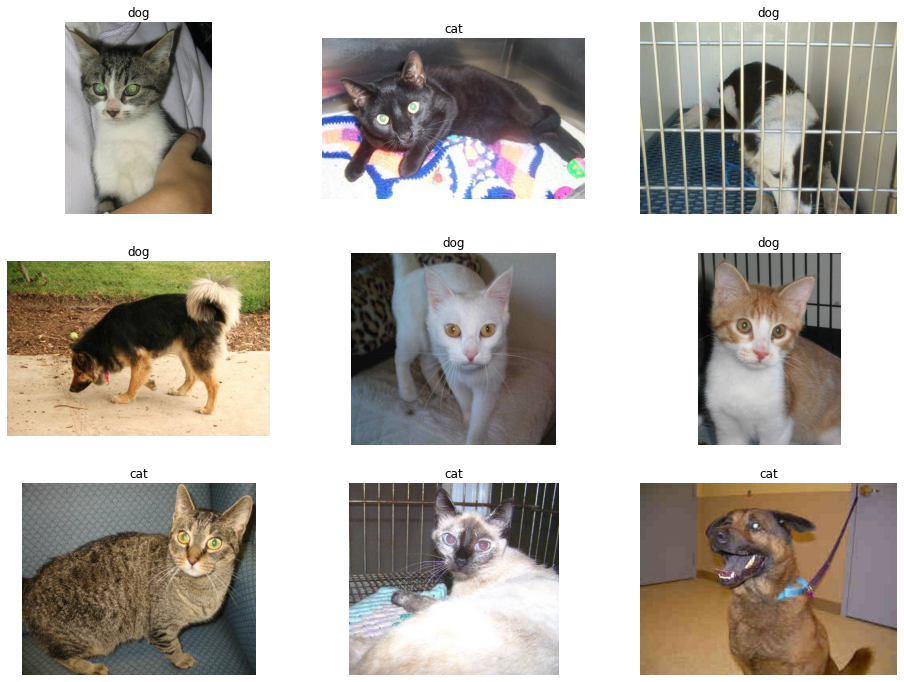

In [ ]:
random_idx = np.random.randint(1, len(test_list), size=9)
fig, axes = plt.subplots(3, 3, figsize=(16, 12))

for idx, ax in enumerate(axes.ravel()):
    img = Image.open(test_list[idx])
    ax.set_title(labels[idx])
    ax.axis('off')
    ax.imshow(img)


In [ ]:
# Делим данные  

train_list, val_test_list = train_test_split(train_list, 
                                             test_size=0.3,
                                             stratify=labels,
                                             random_state=seed)

valid_list, test_list = train_test_split(val_test_list, 
                                       test_size=0.5,
                                       random_state=seed)


In [ ]:
print(f"Train Data: {len(train_list)}")
print(f"Validation Data: {len(valid_list)}")
print(f"Test Data: {len(test_list)}")

Train Data: 17500
Validation Data: 3750
Test Data: 3750


In [ ]:
dc_transforms = transforms.Compose(
    [
        transforms.Resize((224, 224)),
        transforms.ToTensor(),
    ]
)

### Load Datasets

In [ ]:
class CatsDogsDataset(Dataset):
    def __init__(self,  file_list, transform=None, data_dir=DATA_DIR_):
        self.file_list = file_list
        self.transform = transform
        self.data_dir = data_dir

    def __len__(self):
        self.filelength = len(self.file_list)
        return self.filelength

    def __getitem__(self, idx):
        img_path = os.path.join(self.data_dir, self.file_list[idx])
        img = Image.open(img_path)
        img_transformed = self.transform(img)

        label = img_path.split("/")[-1].split(".")[0]
        label = 1 if label == "dog" else 0

        return img_transformed, label

In [ ]:
# Training settings
batch_size = 32
dc_train_data = CatsDogsDataset(train_list, transform=dc_transforms)
dc_valid_data = CatsDogsDataset(valid_list, transform=dc_transforms)
dc_test_data = CatsDogsDataset(test_list, transform=dc_transforms)

dc_train_loader = DataLoader(dataset = dc_train_data, batch_size=batch_size, shuffle=True )
dc_valid_loader = DataLoader(dataset = dc_valid_data, batch_size=batch_size, shuffle=True)
dc_test_loader = DataLoader(dataset = dc_test_data, batch_size=batch_size, shuffle=False)

In [ ]:
print(len(dc_train_data), len(dc_train_loader))

17500 547


In [ ]:
print(len(dc_valid_data), len(dc_valid_loader))

3750 118


### Training

In [ ]:
!kill 2523

In [ ]:
%cd /content
%reload_ext tensorboard
%tensorboard --logdir "tb_logs_vit_vgg_pre_dc"

Output hidden; open in https://colab.research.google.com to view.

### Pretrained VIT + Pretrained VGG

In [ ]:
import pytorch_pretrained_vit
model_name = 'B_16_imagenet1k'
vit_pre_dc = pytorch_pretrained_vit.ViT(model_name, 
                                       image_size=224, 
                                       pretrained=True,
                                       num_classes=2)

Resized positional embeddings from torch.Size([1, 577, 768]) to torch.Size([1, 197, 768])
Loaded pretrained weights.


In [ ]:
from torchvision.models import vgg16_bn
vgg_pre_dc = vgg16_bn(pretrained=True)

In [ ]:
# Меняем последний слой классификатора в модели vgg_pre
vgg_pre_dc.classifier[6] = nn.Linear(4096, 2, bias=True)
vgg_pre_dc

VGG(
  (features): Sequential(
    (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (4): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (7): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (8): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (9): ReLU(inplace=True)
    (10): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (11): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (12): ReLU(inplace=True)
    (13): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (14): Conv2d(128, 256

In [ ]:
# Замораживаю все слои
for param in vgg_pre_dc.parameters():  
    param.requires_grad = False

# Размораживаем последний слой
for param in vgg_pre_dc.classifier[6].parameters():
    param.requires_grad = True

# посмотрим какие параметры нейросети мы учим
params_to_update = []
for name,param in vgg_pre_dc.named_parameters():
    if param.requires_grad == True:
        params_to_update.append(param)
        print("\t",name)    

	 classifier.6.weight
	 classifier.6.bias


In [ ]:
training_vit_pre_dc = Training(device=device, 
                              model=vit_pre_dc.to(device), 
                              name='Vit pre_dc', 
                              log_dir='tb_logs_vit_vgg_pre_dc') 

training_vgg_pre_dc = Training(device=device, 
                               model=vgg_pre_dc.to(device), 
                               name='Vgg pre_dc',
                               log_dir="tb_logs_vit_vgg_pre_dc") 

training_models_dc = [training_vit_pre_dc, training_vgg_pre_dc]

In [ ]:
for mod in training_models_dc:
    print(f'The model {mod.name} has {count_parameters(mod.model):,} trainable parameters')

The model Vit pre_dc has 85,800,194 trainable parameters
The model Vgg pre_dc has 8,194 trainable parameters



Model Vit pre_dc epoch 1/10 : 547, lr: 0.003000,  train loss: 0.007



Model Vit pre_dc epoch 1/10 : 118, lr: 0.003000,  valid loss: 0.027,  valid accuracy: 0.996



Model Vit pre_dc epoch 2/10 : 1094, lr: 0.002100,  train loss: 0.008



Model Vit pre_dc epoch 2/10 : 118, lr: 0.002100,  valid loss: 0.012,  valid accuracy: 0.996



Model Vit pre_dc epoch 3/10 : 1641, lr: 0.001470,  train loss: 0.008



Model Vit pre_dc epoch 3/10 : 118, lr: 0.001470,  valid loss: 0.035,  valid accuracy: 0.995


2021-07-07 14:09:41,070 ignite.handlers.early_stopping.EarlyStopping INFO: EarlyStopping: Stop training



Model Vit pre_dc epoch 3/10 : 118, test accuracy : 0.99
 cat recall : 1.00,            cat precision : 0.99
 dog recall : 0.99,            dog precision : 1.00


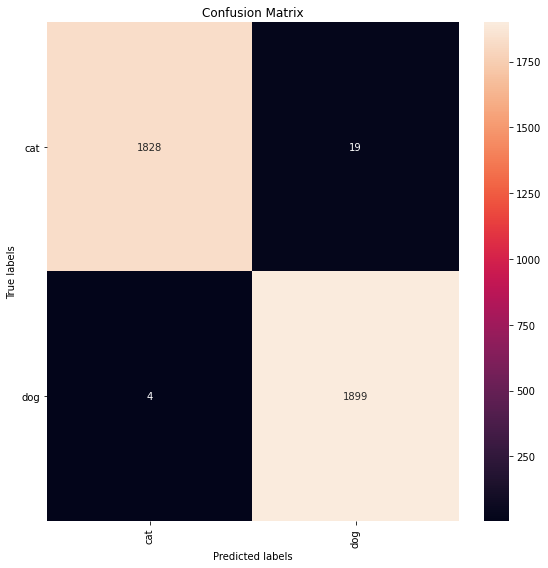


Model Vgg pre_dc epoch 1/10 : 547, lr: 0.003000,  train loss: 0.100



Model Vgg pre_dc epoch 1/10 : 118, lr: 0.003000,  valid loss: 0.040,  valid accuracy: 0.979



Model Vgg pre_dc epoch 2/10 : 1094, lr: 0.003000,  train loss: 0.083



Model Vgg pre_dc epoch 2/10 : 118, lr: 0.003000,  valid loss: 0.046,  valid accuracy: 0.986



Model Vgg pre_dc epoch 3/10 : 1641, lr: 0.003000,  train loss: 0.070



Model Vgg pre_dc epoch 3/10 : 118, lr: 0.003000,  valid loss: 0.085,  valid accuracy: 0.981



Model Vgg pre_dc epoch 4/10 : 2188, lr: 0.003000,  train loss: 0.097



Model Vgg pre_dc epoch 4/10 : 118, lr: 0.003000,  valid loss: 0.067,  valid accuracy: 0.984


2021-07-07 14:20:17,261 ignite.handlers.early_stopping.EarlyStopping INFO: EarlyStopping: Stop training



Model Vgg pre_dc epoch 4/10 : 118, test accuracy : 0.98
 cat recall : 0.99,            cat precision : 0.97
 dog recall : 0.97,            dog precision : 0.99


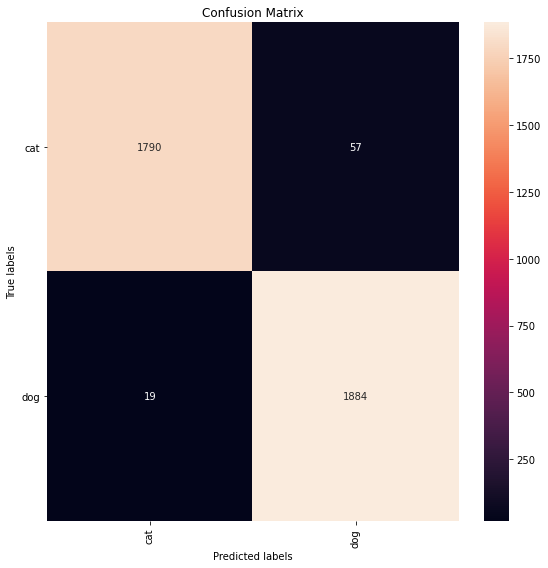

In [ ]:
torch.cuda.empty_cache()

for i, m in enumerate(training_models_dc):
    # определяем оптимайзер
    params = [p for p in m.model.parameters() if p.requires_grad]
    if m.name == 'Vgg pre_dc':
        optimizer = torch.optim.AdamW(params,lr=3e-3)
        clip = None
        patience = 2
        num_epoch = 10
    if m.name == 'Vit pre_dc':
        optimizer = optim.Adam([{"params": params[-2:], "lr": 3e-3},
                                {"params": params[:-2],"lr": 2e-5}])
        clip = 1
        patience=2
        num_epoch = 10
    criterion = nn.CrossEntropyLoss()
    m.load_config(optimizer, criterion, num_epoch, dc_train_loader, dc_valid_loader, dc_test_loader, 
                  ['cat', 'dog'], clip=clip, patience=patience)
    m.run_training_loop()

# Conclusion part 1

Как видно из тренировок предобученных моделей они обучаются достаточно быстро и практически показывают одинаковый результат по качеству на обоих датасетах. Это говорит о том, что у предобученной модели свёрточной сети нет преимуществ перед предобученной моделью VIT, по крайней мере на представленных датасетах(которые не очень большие и сложные). 

# Visual Transformer(part 2)
https://paperswithcode.com/paper/an-image-is-worth-16x16-words-transformers-1

Github links:

* [google-research/vision_transformer](https://github.com/google-research/vision_transformer)
*  [lucidrains/vit-pytorch](https://github.com/lucidrains/vit-pytorch)
* [lukemelas/PyTorch-Pretrained-ViT](https://github.com/lukemelas/PyTorch-Pretrained-ViT)

## Задание
Вторая часть проекта это исследование модели, которая была получена в первой части:<br>
1. Исследование Multi-head attention. Нам интресно рапределение внимания по патчам, и в целом нам интересно какая область картинки наиболее важна для каждого примера.
2. Исследование positional embedding.

## Model structure

In [ ]:
# Сравним attention у трех моделей:
# необученной модели - model_old,
# предобученной модели - model_old_pre,
# предобученной модели обученной на нашем датасете - training_vit_pre.model  

model_old = pytorch_pretrained_vit.ViT(model_name,
                                       image_size=224, 
                                       pretrained=False,
                                       num_classes=33).to(device)
model_old.eval()
pass


model_old_pre = pytorch_pretrained_vit.ViT(model_name,
                                           image_size=224, 
                                           pretrained=True,
                                           num_classes=33).to(device)
model_old_pre.eval()
pass

Resized positional embeddings from torch.Size([1, 577, 768]) to torch.Size([1, 197, 768])
Loaded pretrained weights.


In [ ]:
from termcolor import colored

colors = ['red', 'green', 'blue', 'yellow']

def model_structure(layer, margin=0, item_color=0, deep=0, max_deep=2):
    for name, next_layer in layer.named_children():
        if deep > max_deep:
            return
        next = (0 if not list(next_layer.named_children()) else 1)
        print(colored(' ' * margin + name, colors[item_color]) + ':' * next)
        model_structure(next_layer, margin + len(name) + 2, (item_color + 1) % 4, deep + 1, max_deep=max_deep)

model_structure(model_old, max_deep=2)

def count_parameters(model):
    return sum(p.numel() for p in model.parameters() if p.requires_grad)
print(f'The model has {count_parameters(model_old):,} trainable parameters')

patch_embedding
positional_embedding
transformer:
             blocks:
                     0:
                     1:
                     2:
                     3:
                     4:
                     5:
                     6:
                     7:
                     8:
                     9:
                     10:
                     11:
norm
fc
The model has 85,824,033 trainable parameters


In [ ]:
model_old.transformer.blocks[0]

Block(
  (attn): MultiHeadedSelfAttention(
    (proj_q): Linear(in_features=768, out_features=768, bias=True)
    (proj_k): Linear(in_features=768, out_features=768, bias=True)
    (proj_v): Linear(in_features=768, out_features=768, bias=True)
    (drop): Dropout(p=0.1, inplace=False)
  )
  (proj): Linear(in_features=768, out_features=768, bias=True)
  (norm1): LayerNorm((768,), eps=1e-06, elementwise_affine=True)
  (pwff): PositionWiseFeedForward(
    (fc1): Linear(in_features=768, out_features=3072, bias=True)
    (fc2): Linear(in_features=3072, out_features=768, bias=True)
  )
  (norm2): LayerNorm((768,), eps=1e-06, elementwise_affine=True)
  (drop): Dropout(p=0.1, inplace=False)
)

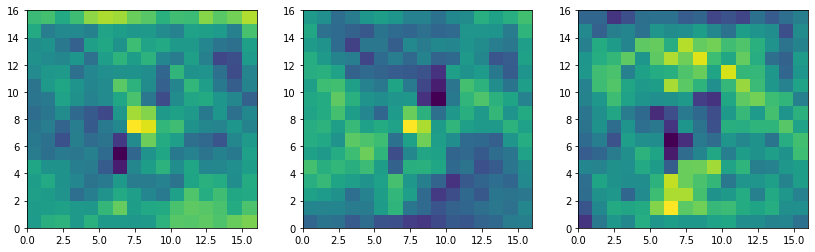

In [ ]:
fig, axs = plt.subplots(1, 3, figsize=(14, 4))
for i in range(3):
    axs[i].pcolormesh(model_old_pre.patch_embedding.weight.data.cpu().detach().numpy()[0, i])
plt.show()

## Comparison of positional embeding

In [ ]:
models = [model_old_pre, training_vit_pre.model]

* Visualize attention: [https://github.com/jeonsworld/ViT-pytorch/blob/main/visualize_attention_map.ipynb](https://github.com/jeonsworld/ViT-pytorch/blob/main/visualize_attention_map.ipynb)
* Show how to get attention scores from our model



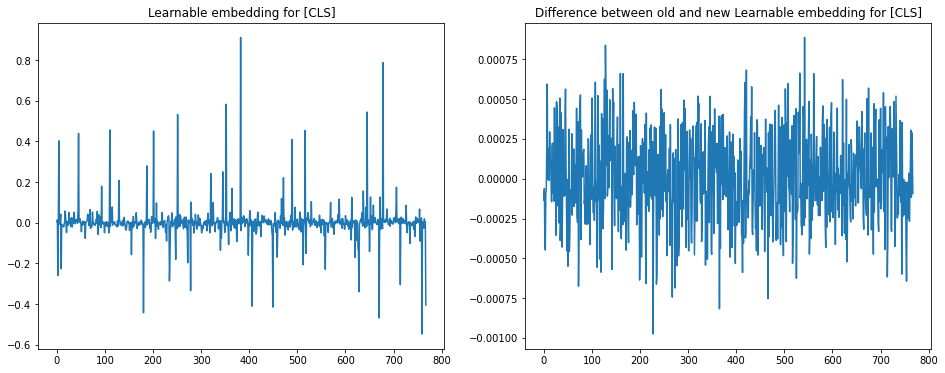

In [ ]:
fig, ax = plt.subplots(ncols=2, figsize=(16, 6))

ax[0].set_title('Learnable embedding for [CLS]')
ax[1].set_title("Difference between old and new Learnable embedding for [CLS]")
old_emb = models[0].class_token[0, 0].cpu().detach().numpy()
new_emb = models[1].class_token[0, 0].cpu().detach().numpy() 
ax[0].plot(old_emb)
ax[1].plot(new_emb - old_emb)
plt.show()

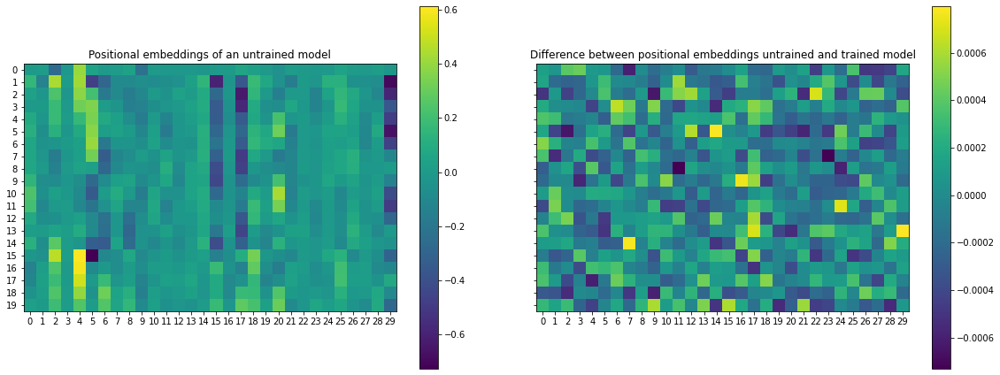

In [ ]:
fig, ax = plt.subplots(ncols=2, figsize=(16, 6),sharey=True)

ax[0].set_title('Positional embeddings of an untrained model')
ax[1].set_title('Difference between positional embeddings untrained and trained model')
old_emb = models[0].positional_embedding.pos_embedding.data
new_emb = models[1].positional_embedding.pos_embedding.data
old = old_emb.cpu()[0].detach().numpy()[:20, :30]
dif = (old_emb - new_emb).cpu()[0].detach().numpy()[:20, :30]
ax[0].xaxis.set_major_locator(ticker.MultipleLocator(1))
ax[0].yaxis.set_major_locator(ticker.MultipleLocator(1))
ax[1].xaxis.set_major_locator(ticker.MultipleLocator(1))
ax[1].yaxis.set_major_locator(ticker.MultipleLocator(1))
p1 = ax[0].imshow(old)
p2 = ax[1].imshow(dif)
fig.colorbar(p1, ax=ax[0])
fig.colorbar(p2, ax=ax[1])
fig.tight_layout()
plt.show()

## Comparison of attention

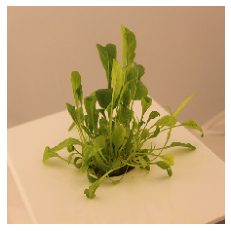

In [ ]:
img_path = data.loc[test_ind[22]].paths
img = Image.open(img_path)
plt.subplot(1, 1, 1)
plt.axis("off")
plt.imshow(img)
plt.show()

In [ ]:
img_transformed = transforms_valid(img)
models.insert(0, model_old)

In [ ]:
# our forward
for model in models:
    x = img_transformed.unsqueeze(0)
    print(x.shape)
    model.eval()
    x = model.patch_embedding(x.to(device))
    print(x.shape)
    x = x.flatten(2).transpose(1, 2)
    print(x.shape)
    x = torch.cat((model.class_token.expand(1, -1, -1), x), dim=1)
    print(x.shape)
    x = model.transformer(x)
    print(x.shape)

torch.Size([1, 3, 224, 224])
torch.Size([1, 768, 14, 14])
torch.Size([1, 196, 768])
torch.Size([1, 197, 768])
torch.Size([1, 197, 768])
torch.Size([1, 3, 224, 224])
torch.Size([1, 768, 14, 14])
torch.Size([1, 196, 768])
torch.Size([1, 197, 768])
torch.Size([1, 197, 768])
torch.Size([1, 3, 224, 224])
torch.Size([1, 768, 14, 14])
torch.Size([1, 196, 768])
torch.Size([1, 197, 768])
torch.Size([1, 197, 768])


In [ ]:
len(models)

3

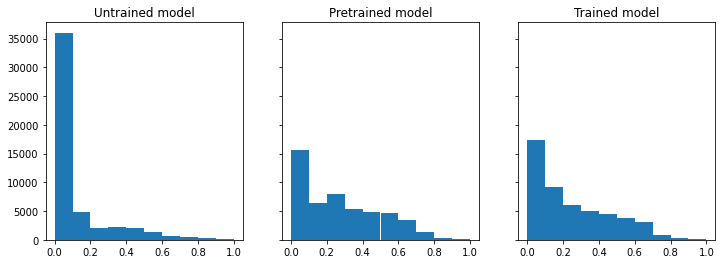

In [ ]:
masks = []
att = []
for model in models:
    att_mat = []
    for block in model.transformer.blocks:
        att_mat.append(block.attn.scores.squeeze(0))    
    # Average the attention weights across all heads.
    att_mat = torch.mean(torch.stack(att_mat), dim=1)
    # To account for residual connections, we add an identity matrix to the
    # attention matrix and re-normalize the weights.
    residual_att = torch.eye(att_mat.size(1)).to(device)
    aug_att_mat = att_mat + residual_att
    aug_att_mat = aug_att_mat / aug_att_mat.sum(dim=-1, keepdim=True)

    # Recursively multiply the weight matrices
    joint_attentions = torch.zeros_like(aug_att_mat).to(device)
    # copy first layer
    joint_attentions[0] = aug_att_mat[0]
    for n in range(1, aug_att_mat.size(0)):
        joint_attentions[n] = aug_att_mat[n] @ joint_attentions[n - 1] 
    att.append(joint_attentions) 

    # Attention from the output token to the input space, last layer
    v = joint_attentions[-1]
    grid_size = int(np.sqrt(aug_att_mat.size(-1)))
    mask = v[0, 1:].reshape(grid_size, grid_size).cpu().detach().numpy()
    mask = cv2.resize(mask / mask.max(), img.size)[..., np.newaxis]
    masks.append(mask)

# Я понял так что далее мы масштабируем маски (возводим в степень 2) 
# и нормализуем от 0 до 1 а затем визуализируем полученные массивы
# используя ravel для перестройки в 1D массив 

fun = lambda x: x ** 2

fig, ax = plt.subplots(ncols=3, figsize=(12, 4),sharey=True)
# # # plt.plot(np.linspace(0, 1, 20), fun(np.linspace(0, 1, 20)))
# # # plt.show()
res_masks = []
titles = ['Untrained model', 'Pretrained model', 'Trained model']
for i in range(len(masks)):
    ax[i].set_title(titles[i])
    res_mask = fun(masks[i])
    res_mask -= res_mask.min()
    res_mask /= res_mask.max()
    res_masks.append(res_mask)
    ax[i].hist(res_mask.ravel())
plt.show()


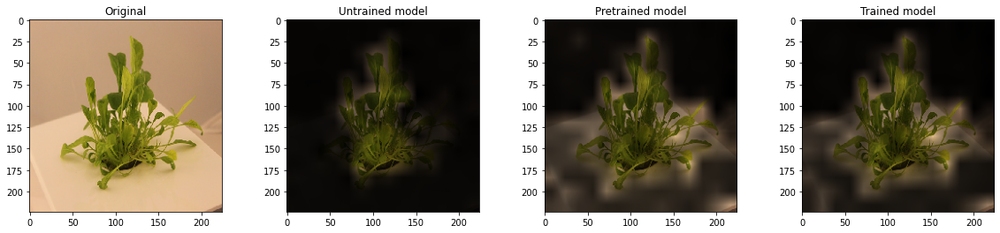

In [ ]:
# Визуализация внимания трех моделей

img = Image.open(img_path)
titles = ['Original', 'Untrained model', 'Pretrained model', 'Trained model']
results = [img]
for res_mask in res_masks:
    results.append((res_mask * img).astype("uint8"))
fig, ax = plt.subplots(ncols=4, figsize=(20, 4))
for i in range(len(results)): 
    ax[i].set_title(titles[i])
    ax[i].imshow(results[i])

In [ ]:
# Визуализация слоёв внимания предобученной модели обученной на данном датасете

results_ = []
for i, v in enumerate(att[2]):
    # Attention from the output token to the input space.
    mask = v[0, 1:].reshape(grid_size, grid_size).cpu().detach().numpy()
    mask = cv2.resize(mask / mask.max(), img.size)[..., np.newaxis]
    result = (mask * img).astype("uint8")
    results_.append(result)

fig, ax = plt.subplots(nrows=3, ncols=4, figsize=(40, 30))
n_layer = 0
for i in range(3):
    for j in range(4):
        ax[i][j].set_title('Attention Map_%d Layer' % (n_layer))
        ax[i][j].imshow(results_[n_layer])
        n_layer += 1

Output hidden; open in https://colab.research.google.com to view.

# Conclusion part 2

Сравнение позиционных эмбеддингов у предобученной и обученной модели показывает на какую величину они изменились в результате обучения модели.
По визуализированным картам распределения внимания разных моделей (не обученной, предобученной и предобученной модели обученной на данном датасете) последовательно показыают как обучались слои внимания от модели к модели. Не обученная модель сосредотачивала все внимание на центре объекта и по мере обучения ее зона внимания расширяется. Предобученная модель старается захватить сам объект и пространство рядом с ним тк еще не знает важно ли оно для данного датасета. У предобученной модели тренированной на данном датасете внимание четко захватывает сам объект и практически не смотрит на фон вокруг объекта.